In [143]:
import pandas as pd
import geopandas as gpd
import matplotlib.pyplot as plt
import numpy as np
from shapely import geometry#判断空间坐标
from matplotlib import colors,cm #自定义色彩
from collections import Counter
import os
from shapely.geometry import Point
import warnings
warnings.filterwarnings('ignore')

In [8]:
area = gpd.read_file('../../data/Hoorn/shape_large/landuse.shp')

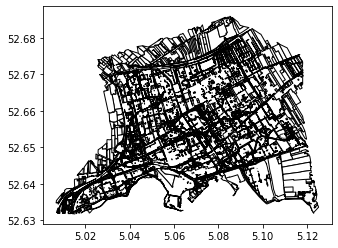

In [9]:
base = area.plot(color='white', edgecolor='black')

In [10]:
litter=pd.read_csv('../../data/Hoorn/Hoorn_OpenLitterMap.csv')

In [11]:
litter_df = gpd.GeoDataFrame(litter).fillna(0)

In [12]:
litter_df

,id,verification,phone,datetime,lat,lon,picked up,address,total_litter,SMOKING,...,ear_plugs,elec_small,elec_large,batteries,balloons.1,life_buoy,other,custom_tag_1,custom_tag_2,custom_tag_3
0,118956,2,iPhone 6,2021-02-03 14:05:54,52.651031,5.081417,Yes,"1, Stijl, Kersenboogerd, Hoorn, North Holland,...",2.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0.0
1,118957,2,iPhone 6,2021-02-03 13:54:23,52.649972,5.082583,Yes,"18, Amstelweg, Kersenboogerd, Hoorn, North Hol...",1.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0.0
2,118958,2,iPhone 6,2021-02-03 14:06:30,52.650917,5.081553,Yes,"2, Stijl, Kersenboogerd, Hoorn, North Holland,...",2.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0.0
3,118959,2,iPhone 6,2021-02-03 14:02:00,52.651183,5.082656,Yes,"47, Stijl, Kersenboogerd, Hoorn, North Holland...",1.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0.0
4,118960,2,iPhone 6,2021-02-03 14:01:17,52.651181,5.082553,Yes,"29, Stijl, Kersenboogerd, Hoorn, North Holland...",1.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19622,279325,2,iPhone 13 mini,2022-03-20 09:46:20,52.652412,5.081511,Yes,"43, Ekster, Kersenboogerd, Hoorn, North Hollan...",1.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0.0
19623,279326,2,iPhone 13 mini,2022-03-20 09:45:09,52.652428,5.080361,Yes,"74, Lijster, Kersenboogerd, Hoorn, North Holla...",1.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0.0
19624,281636,2,iPhone 13 mini,2022-03-20 10:00:23,52.654053,5.079644,Yes,"Spaarneweg, Kersenboogerd, Hoorn, North Hollan...",1.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,brand:oasis,0,0.0
19625,281638,2,iPhone 13 mini,2022-03-20 09:59:52,52.654020,5.079669,Yes,"Spaarneweg, Kersenboogerd, Hoorn, North Hollan...",1.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,0,0.0


In [13]:
xy = [geometry.Point(xy) for xy in zip(litter_df['lon'],litter_df['lat'])]#使用geometry.Point将坐标转换成Point格式

In [14]:
pts = gpd.GeoSeries(xy)

In [15]:
pts

0        POINT (5.08142 52.65103)
1        POINT (5.08258 52.64997)
2        POINT (5.08155 52.65092)
3        POINT (5.08266 52.65118)
4        POINT (5.08255 52.65118)
                   ...           
19622    POINT (5.08151 52.65241)
19623    POINT (5.08036 52.65243)
19624    POINT (5.07964 52.65405)
19625    POINT (5.07967 52.65402)
19626    POINT (5.08124 52.65256)
Length: 19627, dtype: geometry

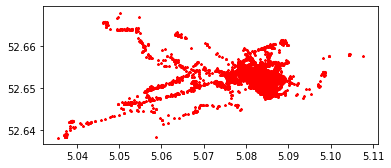

In [16]:
pts.plot(marker='*', color='red', markersize=5)

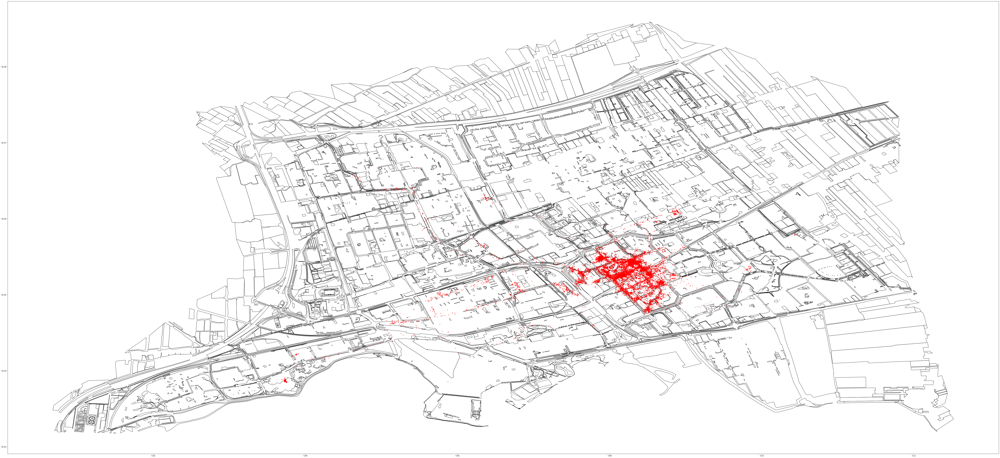

In [17]:
base = area.plot(color='white', edgecolor='black',figsize=(100,100))
pts.plot(ax=base,marker='o', color='red', markersize=5)

In [18]:
pois=gpd.read_file('../../data/Hoorn/shape_large/points.shp')

In [19]:
pois

,osm_id,timestamp,name,type,geometry
0,34050780,None,Museum van de Twintigste Eeuw,museum,POINT (5.06242 52.63508)
1,47051205,None,Avenhorn,motorway_junctio,POINT (5.00851 52.63502)
2,47056631,None,None,crossing,POINT (5.05786 52.63695)
3,47060139,None,None,crossing,POINT (5.05724 52.63817)
4,47069901,None,None,crossing,POINT (5.05239 52.64179)
...,...,...,...,...,...
2397,804881165,None,None,traffic_signals,POINT (5.04726 52.64767)
2398,804881166,None,None,traffic_signals,POINT (5.04692 52.64760)
2399,804881167,None,None,traffic_signals,POINT (5.04659 52.64766)
2400,804881168,None,None,traffic_signals,POINT (5.04734 52.64798)


In [20]:
pois['type'].value_counts().index

Index(['bench', 'waste_basket', 'crossing', 'bus_stop', 'artwork', 'recycling',
       'restaurant', 'traffic_signals', 'signal', 'switch', 'level_crossing',
       'tower', 'post_box', 'pub', 'fast_food', 'school', 'dentist',
       'social_facility', 'bicycle_parking', 'information', 'atm', 'mast',
       'motorway_junctio', 'cafe', 'charging_station', 'ferry_terminal',
       'memorial', 'doctors', 'turning_circle', 'buffer_stop', 'shelter',
       'car_wash', 'street_lamp', 'fuel', 'childcare', 'vending_machine',
       'hotel', 'pharmacy', 'parking_entrance', 'toilets', 'surveillance',
       'veterinary', 'works', 'arts_centre', 'bank', 'drinking_water',
       'car_sharing', 'community_centre', 'kindergarten', 'gallery',
       'ice_cream', 'hospital', 'stop', 'museum', 'windmill', 'parking',
       'station', 'milestone', 'library', 'elevator', 'shower', 'attraction',
       'cannon', 'construction', 'mini_roundabout', 'give_way',
       'railway_crossing', 'clock', 'fountain',

In [21]:
points=pois['geometry']
points = gpd.GeoSeries(points)

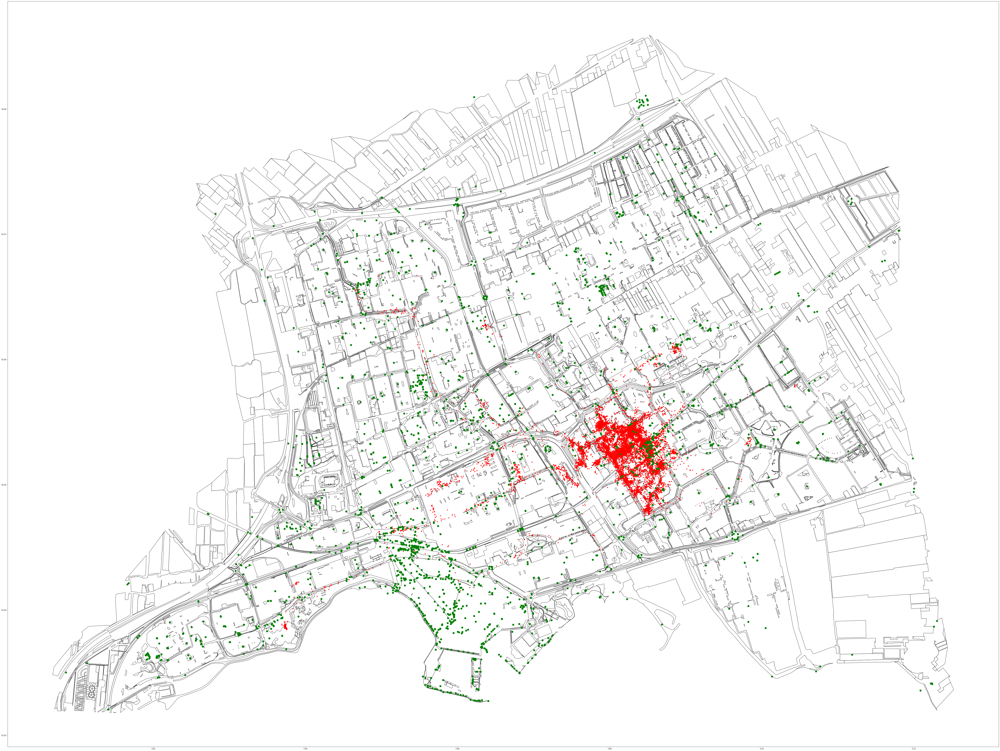

In [22]:
base = area.plot(color='white', edgecolor='black',figsize=(100,100))
pts.plot(ax=base, marker='o', color='red', markersize=20)
points.plot(ax=base,marker='o', color='green', markersize=100)

### Kmeans聚类

In [23]:
from sklearn.cluster import KMeans

In [24]:
X=litter_df.loc[:,'lat':'lon']

In [25]:
X=np.array(X)
X.shape

(19627, 2)

In [26]:
# 聚类数量
k=3

In [27]:
# 训练模型
model = KMeans(n_clusters=k)
model.fit(X)

KMeans(n_clusters=3)

In [28]:
# 分类中心点坐标
centers = model.cluster_centers_

In [29]:
# 预测结果
result = model.predict(X)

In [30]:
result

array([1, 1, 1, ..., 1, 1, 1], dtype=int32)

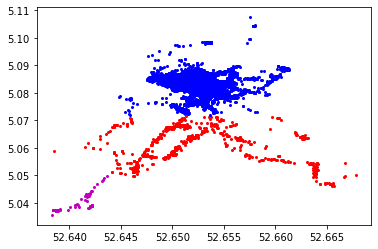

In [31]:
# 用不同的颜色绘制数据点
# mark = ['or','ob', 'oc','om', 'oy','ok']
mark = ['or','ob','om']
for i,item in enumerate(X):
    plt.plot(item[0], item[1], mark[result[i]],markersize=2)

In [32]:
result_df=pd.DataFrame(result)

In [33]:
litter_df[result_df.values==0].shape

(848, 266)

In [34]:
xy0 = [geometry.Point(xy) for xy in zip(litter_df[result_df.values==0]['lon'],litter_df[result_df.values==0]['lat'])]#使用geometry.Point将坐标转换成Point格式

In [35]:
pts0 = gpd.GeoSeries(xy0)

In [36]:
litter_df[result_df.values==1].shape

(18503, 266)

In [37]:
xy1 = [geometry.Point(xy) for xy in zip(litter_df[result_df.values==1]['lon'],litter_df[result_df.values==1]['lat'])]#使用geometry.Point将坐标转换成Point格式

In [38]:
pts1 = gpd.GeoSeries(xy1)

In [39]:
litter_df[result_df.values==2].shape

(276, 266)

In [40]:
xy2 = [geometry.Point(xy) for xy in zip(litter_df[result_df.values==2]['lon'],litter_df[result_df.values==2]['lat'])]#使用geometry.Point将坐标转换成Point格式

In [41]:
pts2 = gpd.GeoSeries(xy2)

In [36]:
# xy3 = [geometry.Point(xy) for xy in zip(litter_df[result_df.values==3]['lon'],litter_df[result_df.values==3]['lat'])]#使用geometry.Point将坐标转换成Point格式

In [37]:
# pts3 = gpd.GeoSeries(xy3)

In [38]:
# litter_df[result_df.values==4].shape

In [39]:
# xy4 = [geometry.Point(xy) for xy in zip(litter_df[result_df.values==4]['lon'],litter_df[result_df.values==4]['lat'])]#使用geometry.Point将坐标转换成Point格式

In [40]:
# pts4 = gpd.GeoSeries(xy4)

In [41]:
# litter_df[result_df.values==5].shape

In [42]:
# xy5 = [geometry.Point(xy) for xy in zip(litter_df[result_df.values==5]['lon'],litter_df[result_df.values==5]['lat'])]#使用geometry.Point将坐标转换成Point格式

In [43]:
# pts5 = gpd.GeoSeries(xy5)

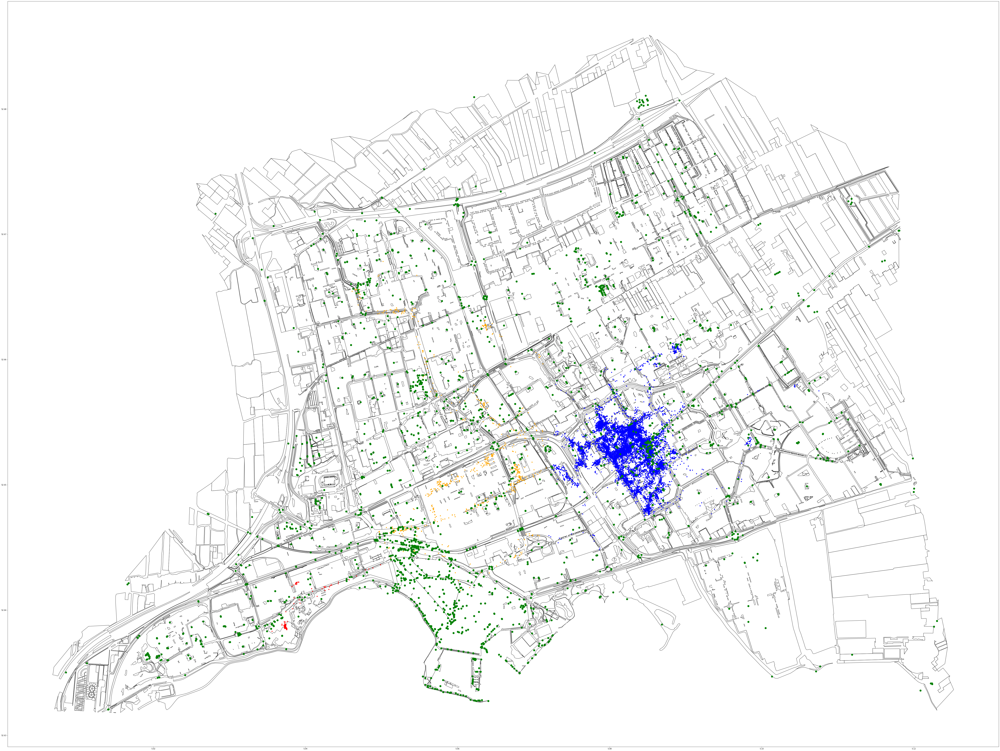

In [42]:
base = area.plot(color='white', edgecolor='black',figsize=(100,100))
pts0.plot(ax=base, marker='o', color='orange', markersize=20)
pts1.plot(ax=base, marker='o', color='blue', markersize=20)
pts2.plot(ax=base, marker='o', color='red', markersize=20)
# pts3.plot(ax=base, marker='o', color='cyan', markersize=20)
# pts4.plot(ax=base, marker='o', color='magenta', markersize=20)
# pts5.plot(ax=base, marker='o', color='yellow', markersize=20)
points.plot(ax=base,marker='o', color='green', markersize=100)

### 提取各分类数据

In [43]:
import shapely.geometry
from shapely.geometry import Point
from shapely.geometry import MultiPoint
from shapely.geometry import Polygon
from shapely.geometry import box

In [66]:
litter1 = litter_df[result_df.values==0].reset_index(drop=True)

In [67]:
litter1=litter1.drop(litter1.loc[:,'custom_tag_1':'custom_tag_3'],axis=1)

In [68]:
litter2 = litter_df[result_df.values==1].reset_index(drop=True)

In [69]:
litter2=litter2.drop(litter2.loc[:,'custom_tag_1':'custom_tag_3'],axis=1)

In [70]:
litter3 = litter_df[result_df.values==2].reset_index(drop=True)

In [71]:
litter3=litter3.drop(litter3.loc[:,'custom_tag_1':'custom_tag_3'],axis=1)

In [72]:
litter1.to_csv('../outdata/litter1.csv')
litter2.to_csv('../outdata/litter2.csv')
litter3.to_csv('../outdata/litter3.csv')

In [52]:
points = MultiPoint(xy1) # 第一类点的积分集合

In [53]:
bound=points.bounds # 它的 x-y 边界框是一个 (minx, miny, maxx, maxy) 元组。

In [54]:
bound

(5.071925, 52.644825, 5.1075166666667, 52.661291666667)

In [47]:
b = box(5.071925, 52.644825, 5.1075166666667, 52.661291666667)# 构建外接矩形

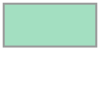

In [48]:
b

In [51]:
poi1=pois['geometry'][pois['geometry'].within(b)]# 筛选出第一类poi

In [52]:
poi1=poi1.reindex().reset_index(drop=True)# 重新对index排序

In [57]:
poi1

0      POINT (5.08178 52.64563)
1      POINT (5.09613 52.64572)
2      POINT (5.08123 52.64583)
3      POINT (5.09686 52.64606)
4      POINT (5.08539 52.65317)
                 ...           
450    POINT (5.09315 52.65340)
451    POINT (5.09327 52.65312)
452    POINT (5.09328 52.65320)
453    POINT (5.09347 52.65318)
454    POINT (5.09364 52.65329)
Name: geometry, Length: 455, dtype: geometry

In [55]:
pd.DataFrame(poi1).to_csv('../poi1.csv')

In [55]:
points2 = MultiPoint(xy0) # 第二类点的积分集合
bound2=points2.bounds 

In [56]:
bound2

(5.0461361111111, 52.638541666667, 5.0716638888889, 52.667838888889)

In [57]:
b = box(5.0461361111111, 52.638541666667, 5.0716638888889, 52.667838888889)# 构建外接矩形

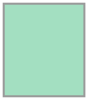

In [58]:
b

In [59]:
poi2=pois['geometry'][pois['geometry'].within(b)]# 筛选出第二类poi

In [60]:
poi2=poi2.reindex().reset_index(drop=True)# 重新对index排序

In [61]:
poi2

0      POINT (5.05239 52.64179)
1      POINT (5.06457 52.64326)
2      POINT (5.06455 52.64340)
3      POINT (5.05161 52.64398)
4      POINT (5.05189 52.64435)
                 ...           
964    POINT (5.04726 52.64767)
965    POINT (5.04692 52.64760)
966    POINT (5.04659 52.64766)
967    POINT (5.04734 52.64798)
968    POINT (5.04717 52.64762)
Name: geometry, Length: 969, dtype: geometry

In [84]:
pd.DataFrame(poi2).to_csv('../outdata/poi2/poi2.csv')

In [65]:
# poi2.to_file('../outdata/poi2/poi2.shp')

In [73]:
points3 = MultiPoint(xy2) # 第二类点的积分集合
bound3=points3.bounds 

In [74]:
bound3

(5.0356027777778, 52.638308333333, 5.0498638888889, 52.643630555556)

In [75]:
b = box(5.0356027777778, 52.638308333333, 5.0498638888889, 52.643630555556)# 构建外接矩形

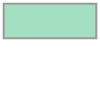

In [76]:
b

In [77]:
poi3=pois['geometry'][pois['geometry'].within(b)]# 筛选出第三类poi

In [79]:
poi3=poi3.reindex().reset_index(drop=True)# 重新对index排序

In [85]:
pd.DataFrame(poi3).to_csv('../outdata/poi3/poi3.csv')

In [81]:
# poi3.to_file('../outdata/poi3/poi3.shp')

## 按天分组

In [132]:
df = pd.read_csv('../outdata/Hoorn_litter_sorted')

In [133]:
df['datetime']=pd.to_datetime(df['datetime'])

In [134]:
df=df.set_index('datetime').sort_index()

In [138]:
df

,id,verification,phone,lat,lon,picked up,address,total_litter,SMOKING,FOOD,COFFEE,ALCOHOL,SOFTDRINKS,SANITARY,COASTAL,BRANDS,OTHER
datetime,,,,,,,,,,,,,,,,,
2021-01-06 14:24:25,259409,2,iPhone 6,52.650306,5.083167,Yes,"47, Messing, Kersenboogerd, Hoorn, North Holla...",1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2021-01-06 14:52:40,259410,2,iPhone 6,52.654744,5.079053,Yes,"Korfbalvereniging ADOS Hoorn, Roerdomp, Kersen...",1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2021-01-06 14:53:23,176577,2,iPhone 6,52.654714,5.078789,Yes,"Roerdomp, Kersenboogerd, Hoorn, North Holland,...",1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
2021-01-07 09:24:45,131285,2,iPhone 6,52.653561,5.085186,Yes,"22, Bolwerk, Kersenboogerd, Hoorn, North Holla...",2.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0
2021-01-08 13:59:32,131143,2,iPhone 6,52.652053,5.080544,Yes,"Ecoproject Het Lantaarntje, Zaanweg, Kersenboo...",2.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2022-03-20 10:19:59,272621,2,iPhone 13 mini,52.652608,5.085050,No,"Zeeman, 104,105, Betje Wolffplein, Winkelcentr...",1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0
2022-03-20 10:20:46,279318,2,iPhone 13 mini,52.652625,5.085294,Yes,"Kruidvat, 106;108, Betje Wolffplein, Winkelcen...",1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2022-03-20 10:21:22,279317,2,iPhone 13 mini,52.652592,5.085286,Yes,"Kruidvat, 106;108, Betje Wolffplein, Winkelcen...",1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0


In [135]:
df_result = [group[1] for group in df.groupby(df.index.date)]# 将结果按天分组并只打印键值对的值

In [147]:
len(df_result)

228

### 删除litter小于4个的天数

In [304]:
tl_day=[]
for i in range(len(df_result)):
    tl_day.append(df_result[i].count()['total_litter'])
    

In [305]:
count = (max(tl_day)+min(tl_day))/2 #164

In [306]:
tl_day

[3,
 1,
 93,
 51,
 43,
 153,
 3,
 1,
 2,
 1,
 45,
 233,
 26,
 277,
 164,
 110,
 279,
 246,
 80,
 175,
 76,
 129,
 17,
 172,
 272,
 42,
 69,
 38,
 52,
 74,
 46,
 56,
 30,
 108,
 109,
 83,
 43,
 150,
 59,
 88,
 99,
 100,
 138,
 81,
 87,
 160,
 133,
 150,
 69,
 94,
 122,
 37,
 61,
 102,
 124,
 170,
 35,
 107,
 76,
 126,
 185,
 26,
 86,
 51,
 82,
 188,
 34,
 18,
 84,
 35,
 59,
 141,
 168,
 29,
 24,
 37,
 141,
 41,
 109,
 56,
 157,
 327,
 142,
 239,
 133,
 105,
 133,
 124,
 244,
 266,
 114,
 146,
 83,
 198,
 199,
 145,
 161,
 52,
 39,
 131,
 104,
 28,
 87,
 233,
 66,
 146,
 102,
 92,
 98,
 94,
 48,
 175,
 58,
 17,
 83,
 127,
 130,
 152,
 50,
 28,
 43,
 117,
 75,
 31,
 85,
 15,
 71,
 77,
 82,
 66,
 81,
 117,
 58,
 128,
 59,
 109,
 32,
 168,
 72,
 98,
 69,
 116,
 44,
 36,
 121,
 90,
 71,
 43,
 124,
 137,
 198,
 212,
 109,
 129,
 173,
 166,
 135,
 3,
 2,
 93,
 86,
 6,
 135,
 5,
 5,
 10,
 1,
 10,
 1,
 8,
 3,
 5,
 1,
 4,
 3,
 5,
 1,
 3,
 2,
 18,
 4,
 3,
 1,
 15,
 19,
 10,
 148,
 31,
 7,
 49,
 9,

In [307]:
tl_day = np.asarray(tl_day)

In [308]:
tl_index = np.where((tl_day==1)+(tl_day==2)+(tl_day==3)) # 筛选出垃圾个数小于4的天数

In [309]:
tl_index[0]

array([  0,   1,   6,   7,   8,   9, 157, 158, 166, 168, 170, 172, 174,
       176, 177, 178, 181, 182])

In [310]:
# tl_day = tl_day.tolist()

In [311]:
tl_index = tl_index[0].tolist()

In [312]:
tl_index.reverse()  # 对索引进行反转，使其从后往前删除

In [313]:
# tl_index

In [314]:
# for i in tl_index:
#     tl_day.pop(i)

In [315]:
for i in tl_index:
    df_result.pop(i)

In [317]:
df_result[0]

,id,verification,phone,lat,lon,picked up,address,total_litter,SMOKING,FOOD,COFFEE,ALCOHOL,SOFTDRINKS,SANITARY,COASTAL,BRANDS,OTHER
datetime,,,,,,,,,,,,,,,,,
2021-01-08 13:59:32,131143,2,iPhone 6,52.652053,5.080544,Yes,"Ecoproject Het Lantaarntje, Zaanweg, Kersenboo...",2.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0
2021-01-08 14:02:03,131570,2,iPhone 6,52.651561,5.080700,Yes,"Zaanweg, Kersenboogerd, Hoorn, North Holland, ...",1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0
2021-01-08 14:09:04,176465,2,iPhone 6,52.651744,5.085119,Yes,"Mina Krusemanstraat, Kersenboogerd, Hoorn, Nor...",1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2021-01-08 14:09:07,256671,2,iPhone 6,52.651519,5.085006,Yes,"Mina Krusemanstraat, Kersenboogerd, Hoorn, Nor...",1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0
2021-01-08 14:09:09,130951,2,iPhone 6,52.651519,5.085006,Yes,"Mina Krusemanstraat, Kersenboogerd, Hoorn, Nor...",2.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2021-01-08 15:22:01,176580,2,iPhone 6,52.650994,5.083033,Yes,"60, Messing, Kersenboogerd, Hoorn, North Holla...",1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
2021-01-08 15:22:03,255071,2,iPhone 6,52.650994,5.083039,Yes,"60, Messing, Kersenboogerd, Hoorn, North Holla...",1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2021-01-08 15:22:06,129741,2,iPhone 6,52.650989,5.083044,Yes,"60, Messing, Kersenboogerd, Hoorn, North Holla...",2.0,0.0,0.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0


In [337]:
for i in range(len(df_result)):
    df_result[i]=df_result[i].reset_index()

In [340]:
df_result[1]

,datetime,id,verification,phone,lat,lon,picked up,address,total_litter,SMOKING,FOOD,COFFEE,ALCOHOL,SOFTDRINKS,SANITARY,COASTAL,BRANDS,OTHER
0,2021-01-09 11:39:27,228175,2,iPhone 6,52.651733,5.075797,Yes,"6, Lepelaar, Kersenboogerd, Hoorn, North Holla...",1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0
1,2021-01-09 11:40:17,258162,2,iPhone 6,52.651558,5.075761,Yes,"6, Lepelaar, Kersenboogerd, Hoorn, North Holla...",1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,2021-01-09 11:53:30,227286,2,iPhone 6,52.643631,5.049864,Yes,"De Weel, Grote Waal, Hoorn, North Holland, Net...",1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0
3,2021-01-09 11:54:11,131581,2,iPhone 6,52.643208,5.047886,Yes,"De Weel, Grote Waal, Hoorn, North Holland, Net...",1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0
4,2021-01-09 12:08:07,259408,2,iPhone 6,52.642058,5.038850,Yes,"Neptunushof, Grote Waal, Hoorn, North Holland,...",1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
5,2021-01-09 12:08:11,129830,2,iPhone 6,52.642236,5.038889,Yes,"18, Neptunushof, Grote Waal, Hoorn, North Holl...",1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
6,2021-01-09 12:08:32,176706,2,iPhone 6,52.642147,5.038806,Yes,"18, Neptunushof, Grote Waal, Hoorn, North Holl...",1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
7,2021-01-09 12:08:34,177087,2,iPhone 6,52.642147,5.038806,Yes,"18, Neptunushof, Grote Waal, Hoorn, North Holl...",1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
8,2021-01-09 12:08:38,176707,2,iPhone 6,52.642147,5.038806,Yes,"18, Neptunushof, Grote Waal, Hoorn, North Holl...",1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
9,2021-01-09 12:08:42,177088,2,iPhone 6,52.642169,5.038875,Yes,"18, Neptunushof, Grote Waal, Hoorn, North Holl...",1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0


## 对垃圾每天聚类

In [341]:
result_list = []
for df_item in df_result:
    X=df_item.loc[:,'lat':'lon']
    X=np.array(X)
    X.shape
    # 聚类数量
    k=4
    # 训练模型
    model = KMeans(n_clusters=k)
    model.fit(X)
    # 分类中心点坐标
    centers = model.cluster_centers_
    # 预测结果
    result = model.predict(X)
    result_list.append(result)
#     # 用不同的颜色绘制数据点
#     mark = ['or','ob', 'oc','om']
#     # mark = ['or','ob','om']
#     for i,item in enumerate(X):
#         plt.plot(item[0], item[1], mark[result[i]],markersize=2)

In [342]:
len(result_list)

210

In [349]:
l = []
for a in result_list:
    l.append(len(a))

In [354]:
np.where(np.asarray(l)==327)

(array([75]),)

In [360]:
Counter(result_list[75]) # 最大的一类有168个垃圾

Counter({3: 67, 1: 168, 0: 56, 2: 36})

In [361]:
for i in range(len(result_list)):
    litter1 = df_result[i][result_list[i]==0].reset_index(drop=True)
    litter2 = df_result[i][result_list[i]==1].reset_index(drop=True)
    litter3 = df_result[i][result_list[i]==2].reset_index(drop=True)
    litter4 = df_result[i][result_list[i]==3].reset_index(drop=True)
    litter1.to_csv('../outdata/litter_days/day{0}_litter1.csv'.format(i))
    litter2.to_csv('../outdata/litter_days/day{0}_litter2.csv'.format(i))
    litter3.to_csv('../outdata/litter_days/day{0}_litter3.csv'.format(i))
    litter4.to_csv('../outdata/litter_days/day{0}_litter4.csv'.format(i))

### 对POI每天聚类